# Wine quality:
The purpose of this study is to determine how well a model can predict the Percieved Quality of based in some of the most relevant physical and chemical properties of wine. The dataset was taken from: 'P. Cortez, A. Cerdeira, F. Almeida, T. Matos and J. Reis. Modeling wine preferences by data mining from physicochemical properties. In Decision Support Systems, Elsevier, 47(4):547-553, 2009'

The there are two datasets, one for red wine and another for white wines. Both contain the same variables but with different number of instances. Only one of the dataset will be chosen to perform the analysis. 

In [17]:
%matplotlib notebook
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import scipy as sp
import IPython
from IPython.display import display
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer
from sklearn import cross_validation
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report


# Importing the dataset:

In [16]:
raw_df_red = pd.read_csv("winequality-red.csv", sep =';')
raw_df_white = pd.read_csv("winequality-white.csv", sep =';')

# Exploring the datasets:

In [3]:
raw_df_red.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000
mean,8.319637,0.527821,0.270976,2.538806,0.087467,15.874922,46.467792,0.996747,3.311113,0.658149,10.422983,5.636023
std,1.741096,0.179060,0.194801,1.409928,0.047065,10.460157,32.895324,0.001887,0.154386,0.169507,1.065668,0.807569
min,4.600000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.990070,2.740000,0.330000,8.400000,3.000000
25%,7.100000,0.390000,0.090000,1.900000,0.070000,7.000000,22.000000,0.995600,3.210000,0.550000,9.500000,5.000000
50%,7.900000,0.520000,0.260000,2.200000,0.079000,14.000000,38.000000,0.996750,3.310000,0.620000,10.200000,6.000000
75%,9.200000,0.640000,0.420000,2.600000,0.090000,21.000000,62.000000,0.997835,3.400000,0.730000,11.100000,6.000000
max,15.900000,1.580000,1.000000,15.500000,0.611000,72.000000,289.000000,1.003690,4.010000,2.000000,14.900000,8.000000


In [4]:

raw_df_white.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000
mean,6.854788,0.278241,0.334192,6.391415,0.045772,35.308085,138.360657,0.994027,3.188267,0.489847,10.514267,5.877909
std,0.843868,0.100795,0.121020,5.072058,0.021848,17.007137,42.498065,0.002991,0.151001,0.114126,1.230621,0.885639
min,3.800000,0.080000,0.000000,0.600000,0.009000,2.000000,9.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,6.300000,0.210000,0.270000,1.700000,0.036000,23.000000,108.000000,0.991723,3.090000,0.410000,9.500000,5.000000
50%,6.800000,0.260000,0.320000,5.200000,0.043000,34.000000,134.000000,0.993740,3.180000,0.470000,10.400000,6.000000
75%,7.300000,0.320000,0.390000,9.900000,0.050000,46.000000,167.000000,0.996100,3.280000,0.550000,11.400000,6.000000
max,14.200000,1.100000,1.660000,65.800000,0.346000,289.000000,440.000000,1.038980,3.820000,1.080000,14.200000,9.000000


The dataset that will be chosen for this exercise will be the white wine dataset since it contains more instances(4898).

In [5]:
raw_df_white.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4898 entries, 0 to 4897
Data columns (total 12 columns):
fixed acidity           4898 non-null float64
volatile acidity        4898 non-null float64
citric acid             4898 non-null float64
residual sugar          4898 non-null float64
chlorides               4898 non-null float64
free sulfur dioxide     4898 non-null float64
total sulfur dioxide    4898 non-null float64
density                 4898 non-null float64
pH                      4898 non-null float64
sulphates               4898 non-null float64
alcohol                 4898 non-null float64
quality                 4898 non-null int64
dtypes: float64(11), int64(1)
memory usage: 459.3 KB


The dataset does not contain missing values or non numerical data.

# White wine training and test set selection: 

To select the training and test set the method .train_test_split() will be used.

In [5]:
X = raw_df_white.iloc[:,:-1].values # independent variables X
y = raw_df_white['quality'].values # dependent Variables y

X_train_white, X_test_white, y_train_white, y_test_white = cross_validation.train_test_split(X, y, test_size = 0.2, random_state = 0)

# Visual Data Exploration

In [7]:
X_train = raw_df_white.iloc[:,:-1]
y_train = raw_df_white['quality']
pd.plotting.scatter_matrix(X_train, c = y_train, figsize = (30, 30), marker ='o', hist_kwds = {'bins': 20},
                            s = 60, alpha = 0.7)


<IPython.core.display.Javascript object>

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x0000018D9F34F438>,
      dtype=object)

Scaling the independent variables using standard scaler. Since the dependent variable is ordinal, there is no need to scale it.

<IPython.core.display.Javascript object>


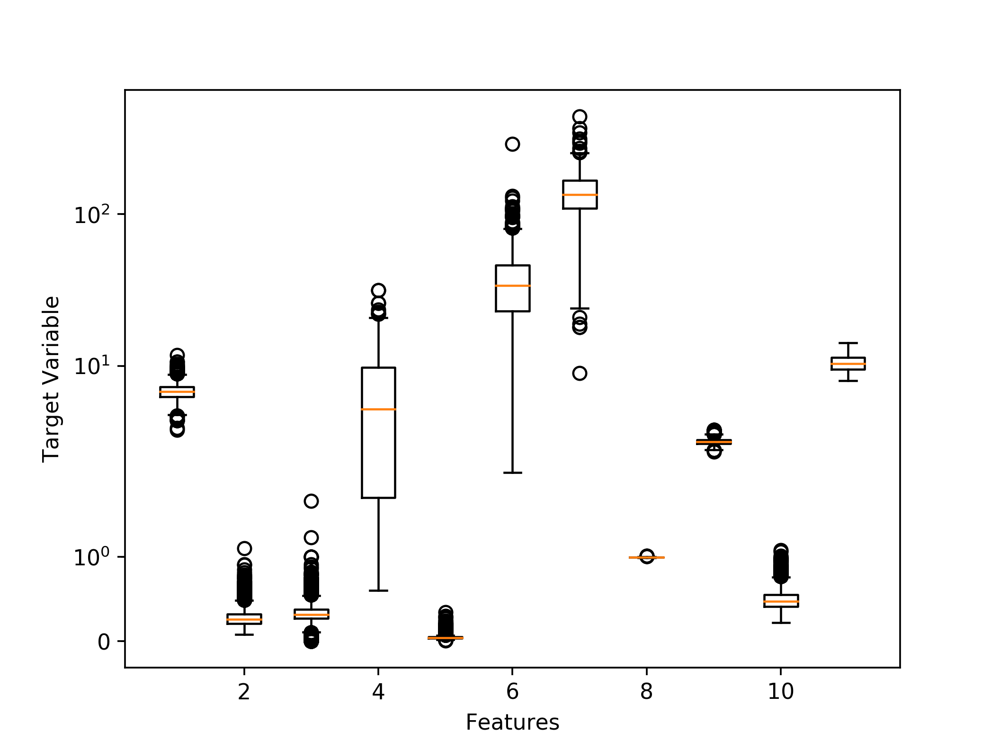

In [8]:
plt.boxplot(X_train_white, manage_xticks = False)
plt.yscale("symlog")
plt.xlabel("Features")
plt.ylabel("Target Variable")
plt.show()

Here, the range of values vary drastically. Standardize scaling will be performed in order to reduce that variability:

In [6]:
scaler = StandardScaler()
#scaler =  MinMaxScaler()
#scaler = Normalizer()
X_train_white = scaler.fit(X_train_white).transform(X_train_white)
X_test_white = scaler.fit(X_test_white).transform(X_test_white)


<IPython.core.display.Javascript object>


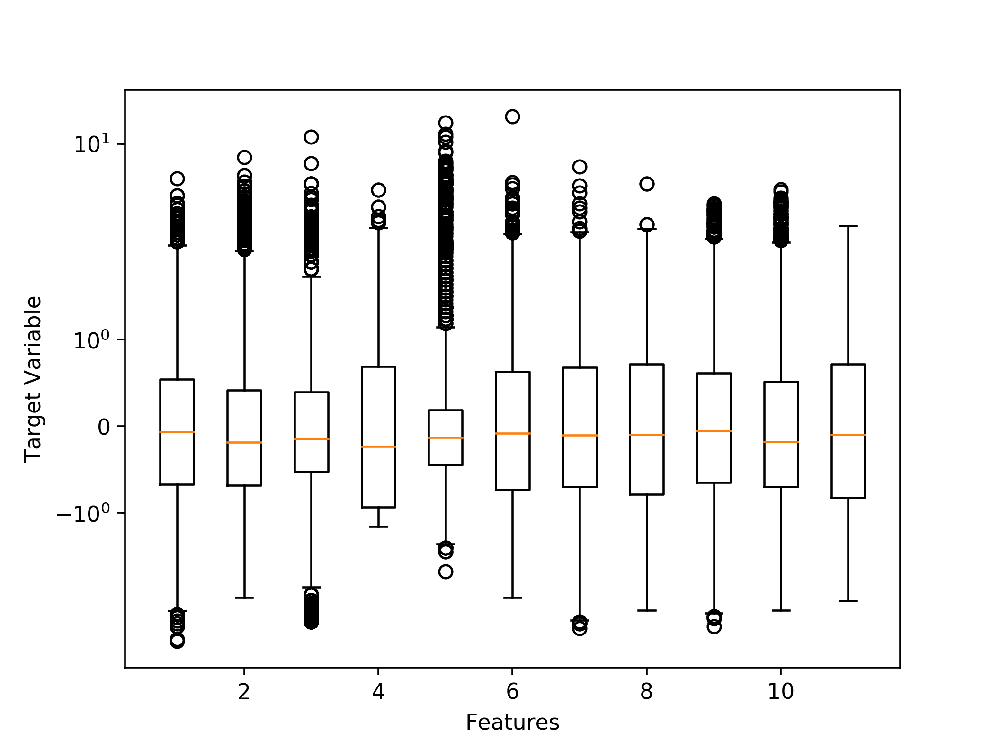

In [11]:
plt.boxplot(X_train_white, manage_xticks = False)
plt.yscale("symlog")
plt.xlabel("Features")
plt.ylabel("Target Variable")
plt.show()

After scaling, The variability of has been reduced significantly 

# Dimensionality reduction

 Performing PCA to check the most relevant variables:

In [12]:
from sklearn.decomposition import PCA
pca = PCA(n_components = None) # input a number for feature extraction

X_train_white = pca.fit_transform(X_train_white)
X_test_white = pca.transform(X_test_white)
explained_var = pca.explained_variance_ratio_
explained_var

array([0.29631274, 0.14101785, 0.11148285, 0.09476468, 0.08750276,
       0.08318285, 0.06648231, 0.05468109, 0.03713087, 0.02616993,
       0.00127206])

Performing Kernel PCA to check the most relevant variables:

In [13]:
from sklearn.decomposition import KernelPCA
kpca = KernelPCA(n_components = None, kernel = 'rbf') # input a number for feature extraction

X_train_white = kpca.fit_transform(X_train_white)
X_test_white = kpca.transform(X_test_white)



In this case, there will  be no feature extraction because the best results are obtained when the variables are untouched.

# KNN

In [10]:

knn = KNeighborsClassifier(n_neighbors = 10, metric = 'manhattan', weights = 'distance', algorithm = 'auto')
knn.fit(X_train_white, y_train_white)
predicted_knn = knn.predict(X_test_white)
# print("Predictions: {}".format(predicted_knn))

Performing cross validation:

In [11]:

scores = cross_val_score(knn, X = X_train_white, y = y_train_white)
print ("Cross Validation Scores: {}".format(scores))

Cross Validation Scores: [0.65343511 0.62222222 0.64620107]


Reporting scores:

In [12]:
report = classification_report(y_test_white, predicted_knn)
print (report)

             precision    recall  f1-score   support

          3       0.00      0.00      0.00         9
          4       1.00      0.12      0.21        51
          5       0.67      0.66      0.66       295
          6       0.60      0.73      0.66       409
          7       0.58      0.57      0.57       183
          8       0.67      0.24      0.36        33

avg / total       0.64      0.62      0.61       980



c:\users\franc\appdata\local\programs\python\python36\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


According to the classification report. The model has an accuracy of 0.64 using KNN. The best results are obtained when using all the independent variables.

# Finding the best parameters for KNN:

In this case, gridsearchCV and a simple loop will be used in order to find the optimal hyperparameters for KNN

In [ ]:


from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
       
params2 = [{'n_neighbors': [1,10,50,100], 'algorithm': ['auto','ball_tree','kd_tree' ], 
            'weights': ['uniform', 'distance'], 'metric': ['minkowski', 'manhattan']}]
                  
grid_search = GridSearchCV(estimator = knn, param_grid = params2, scoring = 'accuracy', cv = 5, n_jobs = 1)
grid_search = grid_search.fit(X_train_white, y_train_white)
accuracy = grid_search.best_score_
best_params = grid_search.best_params_


Due to very slow processing time. This gridsearch calculation had to be done using atom.

Best scores : 0.6687085247575294

Best Params : {'algorithm': 'auto', 'metric': 'minkowski', 'n_neighbors': 50, 'weights': 'distance'}

In [ ]:
print(accuracy)
print(best_params)

<IPython.core.display.Javascript object>


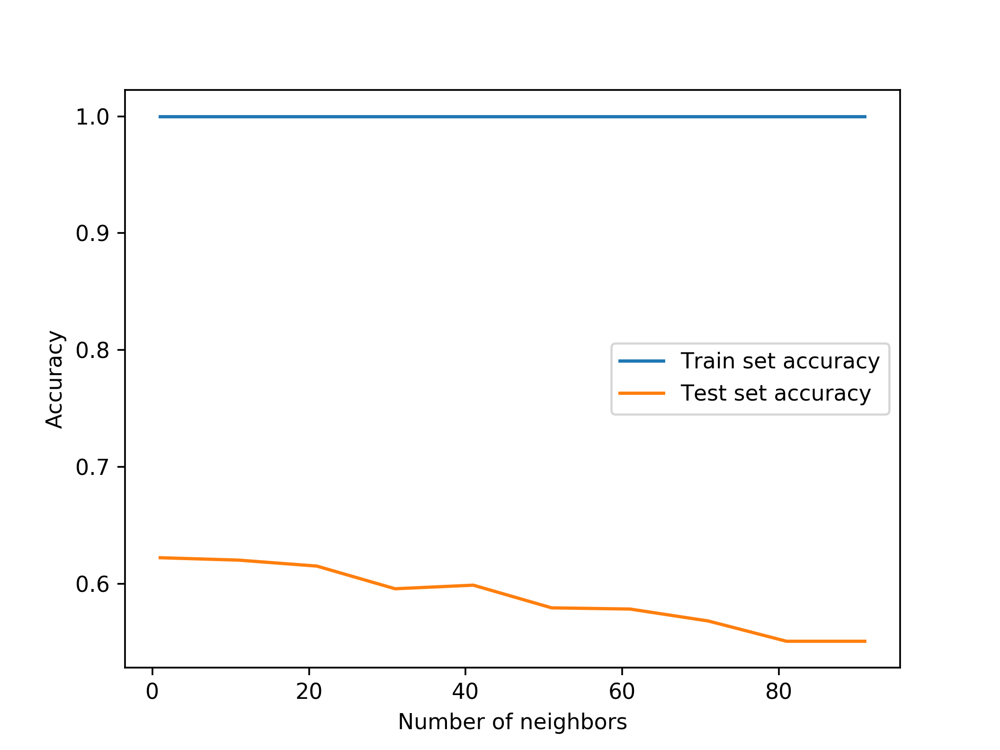

In [13]:
train_accuracy = []
test_accuracy = []

neighbors = range(1,100,10)
algorithms = ['auto', 'ball_tree', 'kd_tree']
weights = ['uniform', 'distance']

for i in neighbors:
    knn = KNeighborsClassifier(n_neighbors = i, metric = 'manhattan', weights = 'distance', algorithm = 'auto')
    knn.fit(X_train_white, y_train_white)
    train_accuracy.append(knn.score(X_train_white, y_train_white))
    test_accuracy.append(knn.score(X_test_white, y_test_white))
plt.plot(neighbors, train_accuracy, label = 'Train set accuracy')
plt.plot(neighbors, test_accuracy, label = 'Test set accuracy')
plt.ylabel("Accuracy")
plt.xlabel("Number of neighbors")
plt.legend()
plt.show()


As it can be appreciated on the figure, the accuracy of the training set is very high which indicates a significant amount of overfitting.

# Kernel SVC:

In [14]:
from sklearn.svm import SVC
svm = SVC(C = 1000, kernel = 'rbf', gamma = 1)
svm.fit(X_train_white, y_train_white)
predicted = svm.predict(X_test_white)

#print("Predictions: {}".format(predicted))

scores = cross_val_score(svm, X = X_train_white, y = y_train_white)
report = classification_report(y_test_white, predicted)
print (report)

# print ("Cross Validation Scores: {}".format(scores))

             precision    recall  f1-score   support

          3       0.00      0.00      0.00         9
          4       0.80      0.08      0.14        51
          5       0.74      0.60      0.66       295
          6       0.58      0.82      0.68       409
          7       0.69      0.54      0.60       183
          8       0.75      0.27      0.40        33

avg / total       0.66      0.64      0.61       980



c:\users\franc\appdata\local\programs\python\python36\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


# Finding the best parameters for Kernel SVC:

In [ ]:
params = [{'C': [1, 10, 100, 1000], 'kernel': ['rbf'], 'gamma': [1, 0.1, 0.01, 0.001]}]
     
         
                  
grid_search = GridSearchCV(estimator = svm, param_grid = params, scoring = 'accuracy', cv = 5, n_jobs =1)
grid_search = grid_search.fit(X_train_white, y_train_white)
accuracySVC = grid_search.best_score_
best_paramsSVC = grid_search.best_params_

Due to very slow processing time. This gridsearch calculation had to be done using IDE.

Best Score: 0.6482899438489025



Best Params : {'C': 10, 'gamma': 1, 'kernel': 'rbf'}

<IPython.core.display.Javascript object>


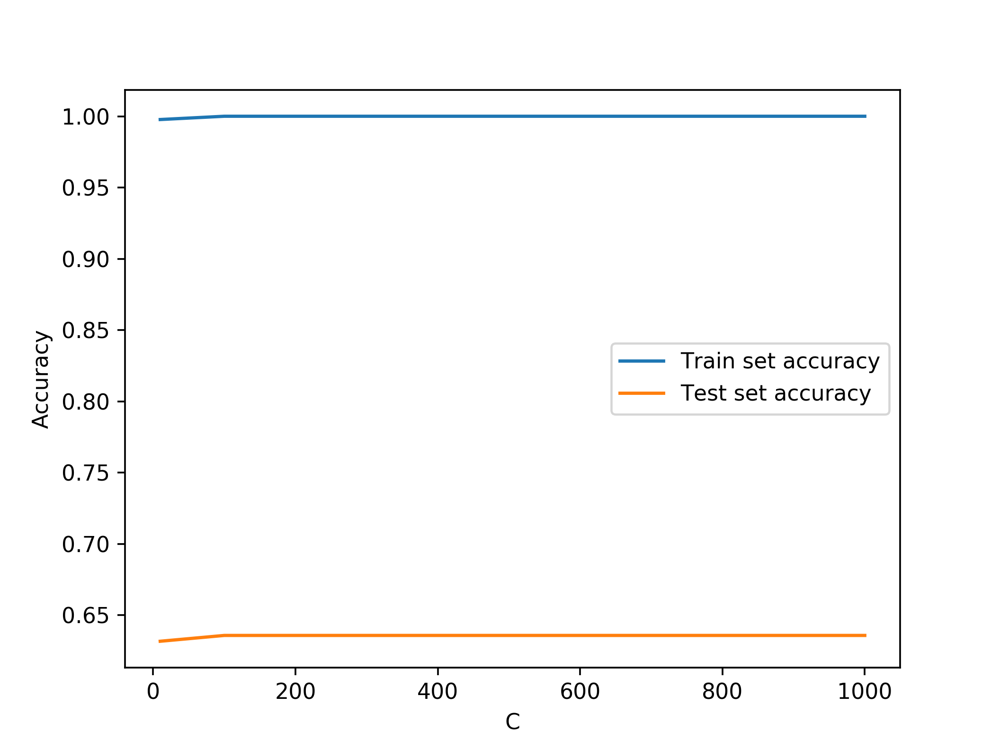

In [15]:
train_accuracy = []
test_accuracy = []

Ci = [10, 100, 1000]

for i in Ci:
    svm = SVC(C = i, kernel = 'rbf', gamma = 1) # try rbf, linear and poly
    svm.fit(X_train_white, y_train_white)
    train_accuracy.append(svm.score(X_train_white, y_train_white))
    test_accuracy.append(svm.score(X_test_white, y_test_white))
plt.plot(Ci, train_accuracy, label = 'Train set accuracy')
plt.plot(Ci, test_accuracy, label = 'Test set accuracy')
plt.ylabel("Accuracy")
plt.xlabel("C")
plt.legend()
plt.show()

As it happened with the previous model, the accuracy of the training set is very high which indicates a significant amount of overfitting.

# Descretization of the input variables in two clasess:


In [37]:
Xi = raw_df_white.iloc[:,:-1] # independent variables X
yi = raw_df_white['quality']

Xi = pd.DataFrame(Xi)
Xi.describe()


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
count,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000
mean,6.854788,0.278241,0.334192,6.391415,0.045772,35.308085,138.360657,0.994027,3.188267,0.489847,10.514267
std,0.843868,0.100795,0.121020,5.072058,0.021848,17.007137,42.498065,0.002991,0.151001,0.114126,1.230621
min,3.800000,0.080000,0.000000,0.600000,0.009000,2.000000,9.000000,0.987110,2.720000,0.220000,8.000000
25%,6.300000,0.210000,0.270000,1.700000,0.036000,23.000000,108.000000,0.991723,3.090000,0.410000,9.500000
50%,6.800000,0.260000,0.320000,5.200000,0.043000,34.000000,134.000000,0.993740,3.180000,0.470000,10.400000
75%,7.300000,0.320000,0.390000,9.900000,0.050000,46.000000,167.000000,0.996100,3.280000,0.550000,11.400000
max,14.200000,1.100000,1.660000,65.800000,0.346000,289.000000,440.000000,1.038980,3.820000,1.080000,14.200000


In [47]:
Xi = raw_df_white.iloc[:,:-1] # independent variables X
yi = raw_df_white['quality']

Xi = pd.DataFrame(Xi)


# transforming to boolean integers.

Xi['fixed acidity'] = (Xi.iloc[:, 0] >= 6.8)*1
Xi['volatile acidity'] = (Xi.iloc[:, 1] >= 0.26)*1
Xi['citric acid'] = (Xi.iloc[:, 2] >= 0.32)*1
Xi['residual sugar'] = (Xi.iloc[:, 3] >= 5.2)*1
Xi['chlorides'] = (Xi.iloc[:, 4] >= 0.043)*1
Xi['free sulfur dioxide'] = (Xi.iloc[:, 5] >= 34)*1
Xi['total sulfur dioxide'] = (Xi.iloc[:, 6] >= 134)*1
Xi['density'] = (Xi.iloc[:, 7] >= 0.9937)*1
Xi['pH'] = (Xi.iloc[:, 8] >= 3.18)*1
Xi['sulphates'] = (Xi.iloc[:, 9] >= 0.47)*1
Xi['alcohol'] = (Xi.iloc[:, 10] >= 10.4)*1


# KNN with discrete

In [50]:
X_train_white, X_test_white, y_train_white, y_test_white = cross_validation.train_test_split(Xi, y, test_size = 0.2, random_state = 0)

In [71]:
#scaler = StandardScaler()
scaler =  MinMaxScaler()
#scaler = Normalizer()
X_train_white = scaler.fit(X_train_white).transform(X_train_white)
X_test_white = scaler.fit(X_test_white).transform(X_test_white)


In [78]:
knn = KNeighborsClassifier(n_neighbors = 50, metric = 'manhattan', weights = 'distance', algorithm = 'auto')
knn.fit(X_train_white, y_train_white)
predicted_knn = knn.predict(X_test_white)

In [79]:
scores = cross_val_score(knn, X = X_train_white, y = y_train_white)
print ("Cross Validation Scores: {}".format(scores))


Cross Validation Scores: [0.52900763 0.49348659 0.48119724]


In [80]:
report = classification_report(y_test_white, predicted_knn)
print (report)

             precision    recall  f1-score   support

          3       0.00      0.00      0.00         9
          4       0.42      0.10      0.16        51
          5       0.53      0.58      0.56       295
          6       0.52      0.64      0.57       409
          7       0.51      0.34      0.41       183
          8       0.38      0.18      0.24        33

avg / total       0.51      0.52      0.50       980



In [82]:
svm = SVC(C = 10, kernel = 'rbf', gamma = 1)
svm.fit(X_train_white, y_train_white)
predicted = svm.predict(X_test_white)

#print("Predictions: {}".format(predicted))

scores = cross_val_score(svm, X = X_train_white, y = y_train_white)
report = classification_report(y_test_white, predicted)
print (report)

             precision    recall  f1-score   support

          3       0.00      0.00      0.00         9
          4       0.00      0.00      0.00        51
          5       0.57      0.48      0.52       295
          6       0.49      0.74      0.59       409
          7       0.50      0.32      0.39       183
          8       0.00      0.00      0.00        33

avg / total       0.47      0.51      0.47       980



c:\users\franc\appdata\local\programs\python\python36\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


Performing the discretization of the input variables does not increase accuracy, on the contrary, it significantly reduces it.

Continuing in part two.......